<a href="https://colab.research.google.com/github/sushil1902/Projects/blob/Proj/Concrete_compresive_strength_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <center>**Concrete compresive strength prediction**</center>

**1. Importing of Library and loading of Dataset**

In [1]:
import numpy as np
import pandas as pd

# for Ploting
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data = pd.read_csv('https://raw.githubusercontent.com/sushil1902/Datasets/main/concrete_train.csv')

In [3]:
data.head()

,Id,cement,slag,flyash,water,superplasticizer,coarseaggregate,fineaggregate,age,csMPa
0,995,158.6,148.9,116.0,175.1,15.0,953.3,719.7,28,27.68
1,507,424.0,22.0,132.0,178.0,8.5,822.0,750.0,28,62.05
2,334,275.1,0.0,121.4,159.5,9.9,1053.6,777.5,3,23.80
3,848,252.0,97.0,76.0,194.0,8.0,835.0,821.0,28,33.40
4,294,168.9,42.2,124.3,158.3,10.8,1080.8,796.2,3,7.40


In [4]:
# standardize the column header
data.columns = map(str.lower,data.columns)
data.columns

Index(['id', 'cement', 'slag', 'flyash', 'water', 'superplasticizer',
       'coarseaggregate', 'fineaggregate', 'age', 'csmpa'],
      dtype='object')

In [5]:
data.head()

,id,cement,slag,flyash,water,superplasticizer,coarseaggregate,fineaggregate,age,csmpa
0,995,158.6,148.9,116.0,175.1,15.0,953.3,719.7,28,27.68
1,507,424.0,22.0,132.0,178.0,8.5,822.0,750.0,28,62.05
2,334,275.1,0.0,121.4,159.5,9.9,1053.6,777.5,3,23.80
3,848,252.0,97.0,76.0,194.0,8.0,835.0,821.0,28,33.40
4,294,168.9,42.2,124.3,158.3,10.8,1080.8,796.2,3,7.40


In [6]:
data1 = data.copy()
data1.sample()

,id,cement,slag,flyash,water,superplasticizer,coarseaggregate,fineaggregate,age,csmpa
745,1,540.0,0.0,0.0,162.0,2.5,1055.0,676.0,28,61.89


In [7]:
data1.columns

Index(['id', 'cement', 'slag', 'flyash', 'water', 'superplasticizer',
       'coarseaggregate', 'fineaggregate', 'age', 'csmpa'],
      dtype='object')

In [8]:
data1 = data1.rename(columns={'flyash':'fly_ash','coarseaggregate':'coarse_aggregate','fineaggregate':'fine_aggregate'})

In [9]:
data1.head()

,id,cement,slag,fly_ash,water,superplasticizer,coarse_aggregate,fine_aggregate,age,csmpa
0,995,158.6,148.9,116.0,175.1,15.0,953.3,719.7,28,27.68
1,507,424.0,22.0,132.0,178.0,8.5,822.0,750.0,28,62.05
2,334,275.1,0.0,121.4,159.5,9.9,1053.6,777.5,3,23.80
3,848,252.0,97.0,76.0,194.0,8.0,835.0,821.0,28,33.40
4,294,168.9,42.2,124.3,158.3,10.8,1080.8,796.2,3,7.40


In [10]:
# checking and handling the missing data
data1.dtypes

id                    int64
cement              float64
slag                float64
fly_ash             float64
water               float64
superplasticizer    float64
coarse_aggregate    float64
fine_aggregate      float64
age                   int64
csmpa               float64
dtype: object

In [11]:
data.duplicated().sum()

0

In [12]:
data1.isnull().sum()

id                  0
cement              0
slag                0
fly_ash             0
water               0
superplasticizer    0
coarse_aggregate    0
fine_aggregate      0
age                 0
csmpa               0
dtype: int64

In [13]:
data1.isna().sum()

id                  0
cement              0
slag                0
fly_ash             0
water               0
superplasticizer    0
coarse_aggregate    0
fine_aggregate      0
age                 0
csmpa               0
dtype: int64

## Outliers treatment

In [14]:
data1.fly_ash.unique()

array([116. , 132. , 121.4,  76. , 124.3, 167. ,   0. , 118.6, 165.7,
       118.3, 123. , 120. , 141. ,  24.5, 112.3, 125.2, 143. ,  94.1,
       173.5, 122. , 127.7, 161. ,  77. , 174.2, 128. , 174.7, 100.4,
       163.3, 106.7,  95.7, 121.6, 123.8,  98.8, 119.8,  95.6, 143.6,
       124.8, 137. , 182. , 100.5, 148. , 166. , 118.2,  97. , 163.8,
       185. , 182.1, 132.1, 111.9, 113. , 112.6, 125.1, 159.9, 124.1,
       106.2,  71. ,  96.2, 128.6,  79. ,  99.9,  59. ,  89. , 108.6,
       111. , 143.2, 132.6, 107. ,  94.6,  81.8,  96.7, 172.4,  78. ,
        94. , 178.9, 194. , 111.2, 185.3, 121.9, 158. , 126. ,  78.4,
       133. , 117.5, 125.4, 146. ,  90. ,  97.4, 146.4, 142.8, 184. ,
       100. ,  92. , 174.9, 150.4, 103.3, 141.6,  86. , 138.7, 134. ,
        93.9, 126.5,  98. , 113.2, 129.7,  95. , 172. ,  71.5, 136.6,
       138. ,  91.7, 160.9, 190. , 115.6, 195. , 175. , 183.9, 164. ,
       103. , 125.8, 163. , 119. , 194.9, 127.9, 107.5,  86.5, 112. ,
       142.7,  91. ,

In [15]:
data1 = data1.drop('id',axis=1)
data1.sample()

,cement,slag,fly_ash,water,superplasticizer,coarse_aggregate,fine_aggregate,age,csmpa
188,290.4,0.0,96.2,168.1,9.4,961.2,865.0,14,34.67


In [16]:
data1.columns

Index(['cement', 'slag', 'fly_ash', 'water', 'superplasticizer',
       'coarse_aggregate', 'fine_aggregate', 'age', 'csmpa'],
      dtype='object')

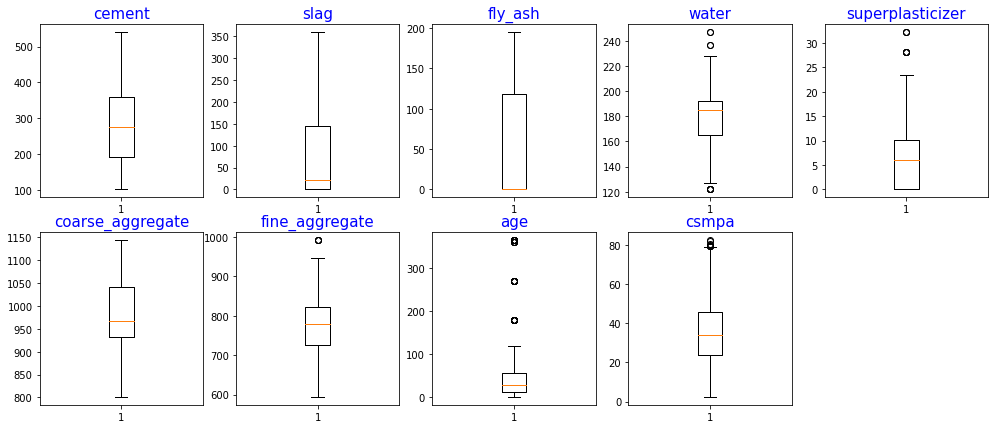

In [17]:
outliers_by_variables = data1.columns
plt.figure(figsize=(17,7))
for i in range(0,outliers_by_variables.shape[0]):
  plt.subplot(2,5,i+1)
  plt.boxplot(data1[outliers_by_variables[i]],autorange= True)
  plt.title(outliers_by_variables[i],fontdict= {'fontsize': 15 ,'fontweight': 5,'color':'b'})

In [18]:
def min_max_value(data1,column):
  print("Minimum value of {} is {} \nMaximum value of {} is {}".format(column,data1[column].min(),column,data1[column].max()))

In [19]:
data.columns

Index(['id', 'cement', 'slag', 'flyash', 'water', 'superplasticizer',
       'coarseaggregate', 'fineaggregate', 'age', 'csmpa'],
      dtype='object')

In [20]:
for i in data1.columns:
  min_max_value(data1,i)

Minimum value of cement is 102.0 
Maximum value of cement is 540.0
Minimum value of slag is 0.0 
Maximum value of slag is 359.4
Minimum value of fly_ash is 0.0 
Maximum value of fly_ash is 195.0
Minimum value of water is 121.8 
Maximum value of water is 247.0
Minimum value of superplasticizer is 0.0 
Maximum value of superplasticizer is 32.2
Minimum value of coarse_aggregate is 801.0 
Maximum value of coarse_aggregate is 1145.0
Minimum value of fine_aggregate is 594.0 
Maximum value of fine_aggregate is 992.6
Minimum value of age is 1 
Maximum value of age is 365
Minimum value of csmpa is 2.33 
Maximum value of csmpa is 82.6


In [21]:
data1 =data1[data1['slag']<350]
data1=data1[(data1["water"]<246) & (data1["water"]>122)]
data1=data1[data1["superplasticizer"]<25]
data1=data1[data1["fine_aggregate"]<992]
data1=data1[data1["age"]<150]

# Data Visualization

In [22]:
! pip install sweetviz

In [23]:
import sweetviz as sv
sweet_report =sv.analyze(data1)
sweet_report.show_html('sweet_report.html')

                                             |          | [  0%]   00:00 -> (? left)

Report sweet_report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


<AxesSubplot:>

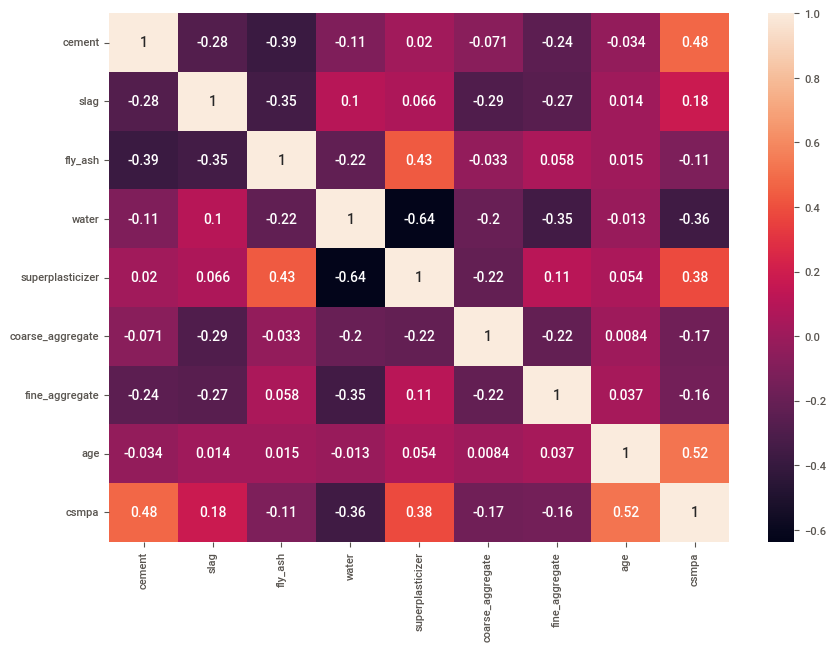

In [24]:
plt.figure(figsize=(10,7))
sns.heatmap(data1.corr(),annot= True)

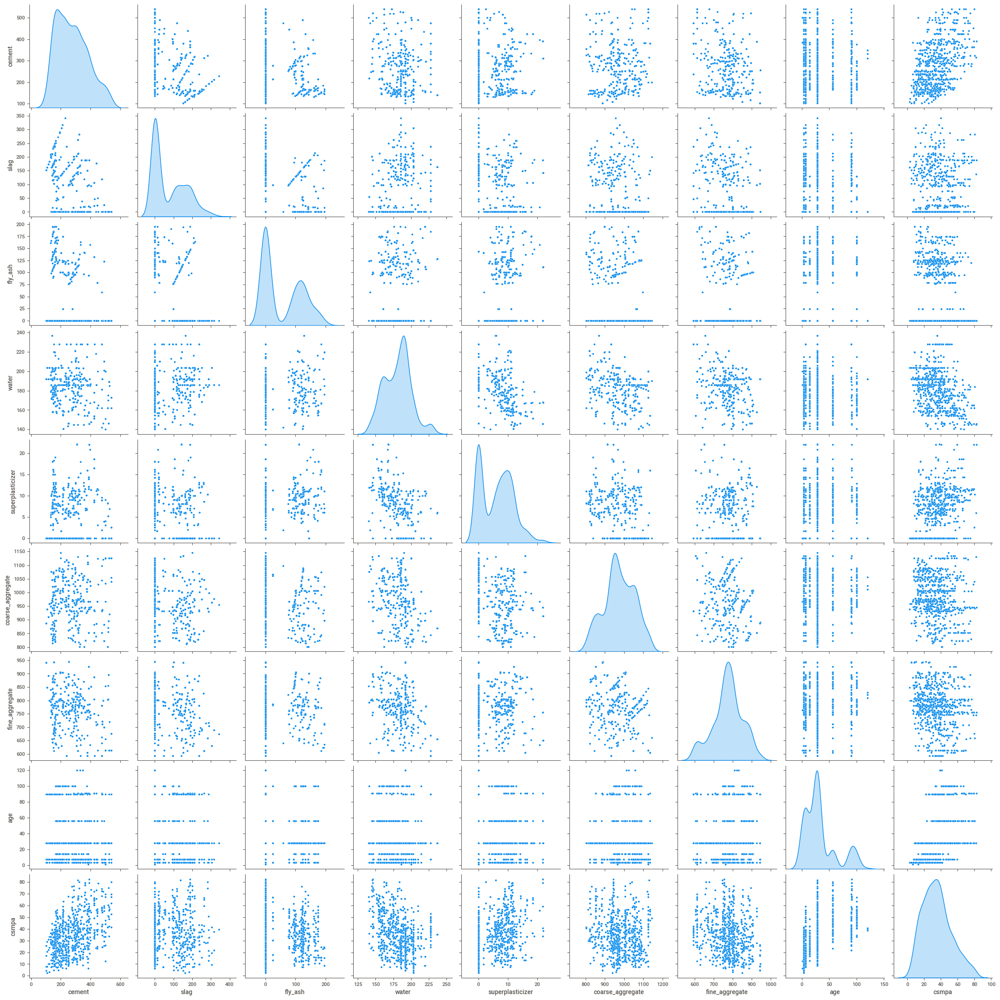

In [25]:
sns.pairplot(data1,diag_kind='kde')

In [26]:
! pip install autoviz

Alert! from autoviz version 0.1.35, after importing, you must %matplotlib inline to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
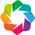

Shape of your Data Set loaded: (824, 10)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    10 Predictors classified...
        1 variables removed since they were ID or low-information variables
Number of All Scatter Plots = 36
Time to run AutoViz = 6 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


<Figure size 1000x800 with 0 Axes>

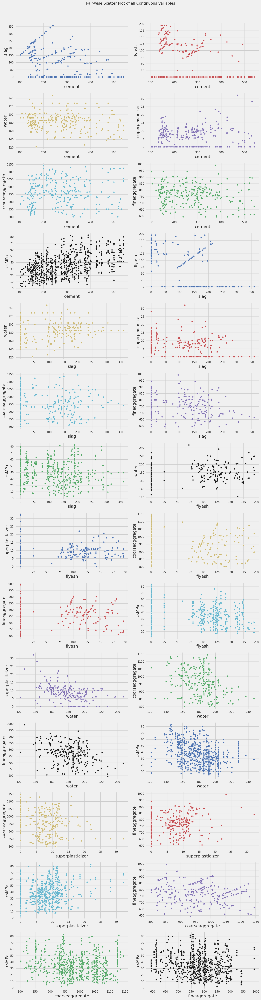

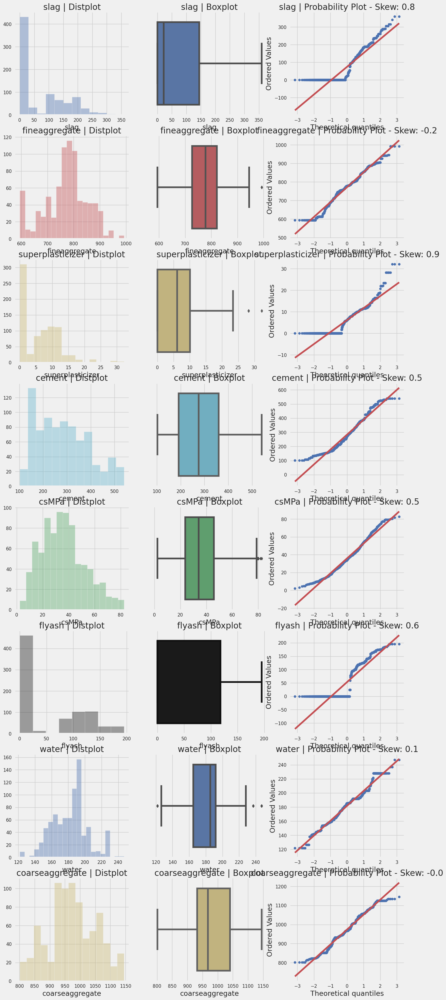

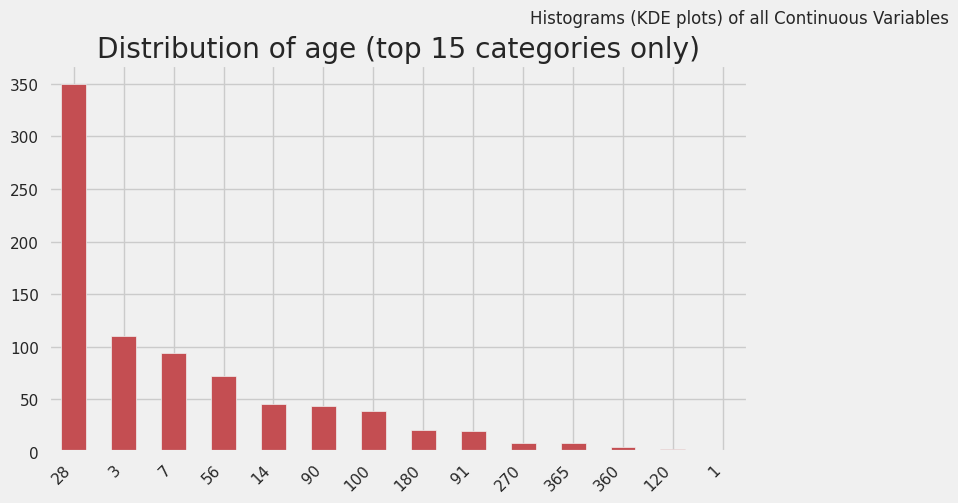

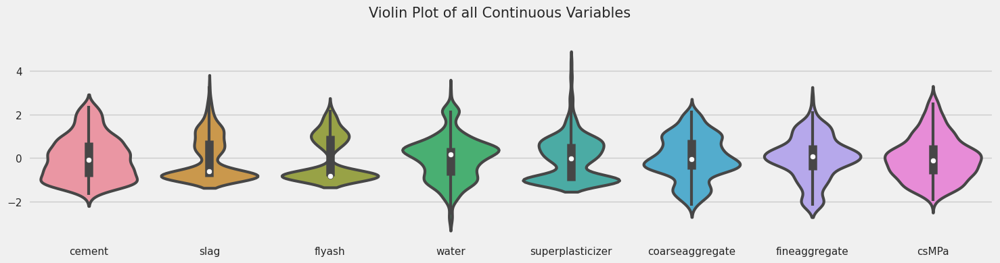

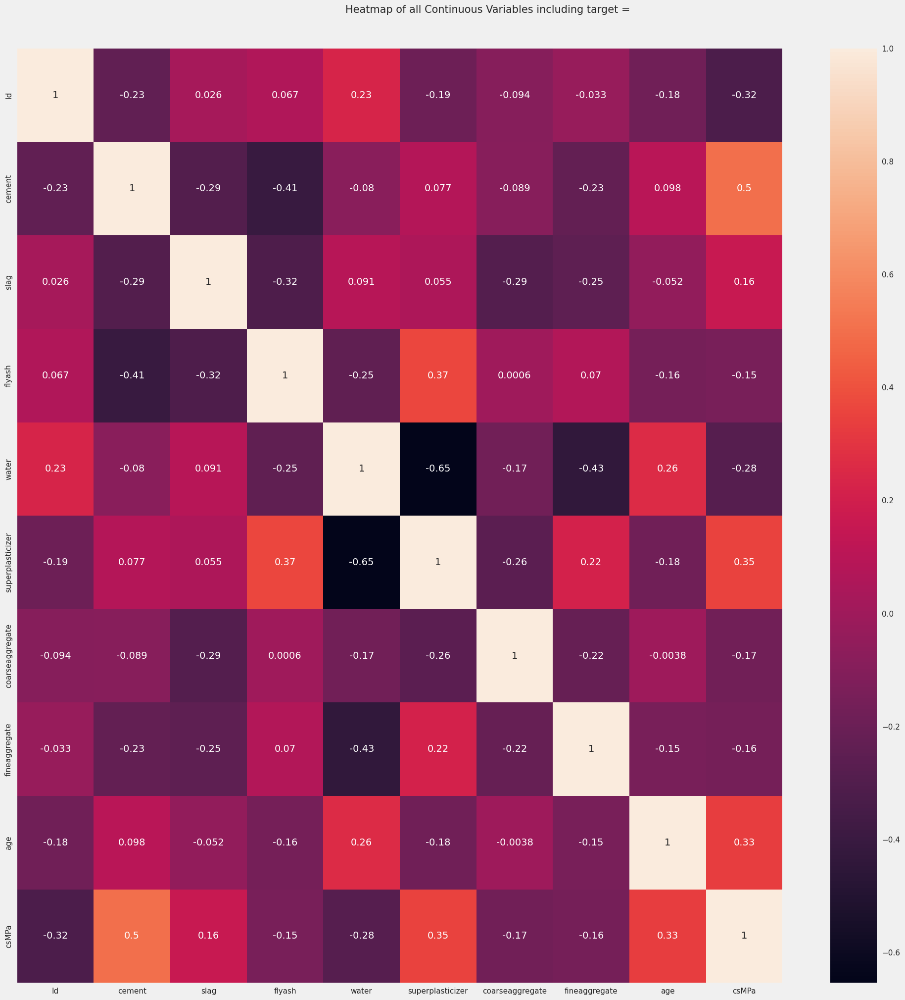

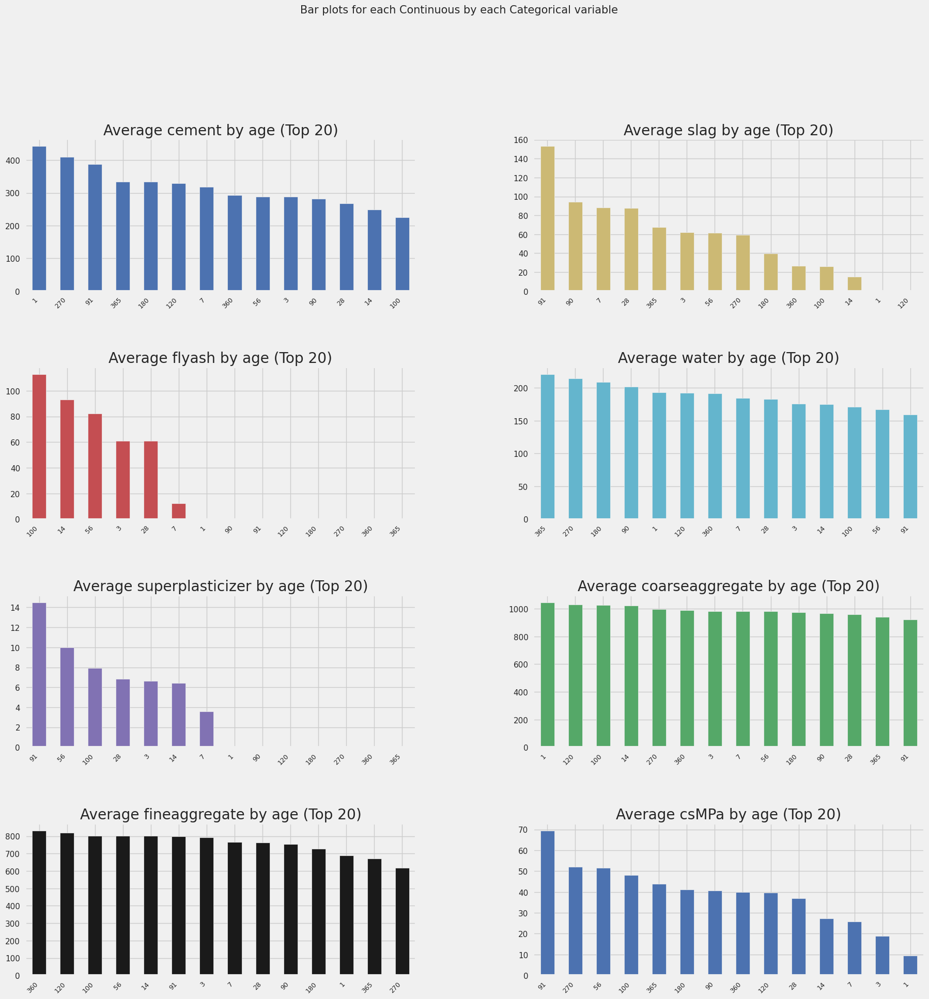

In [27]:
from autoviz.AutoViz_Class import AutoViz_Class
plt.figure(figsize=(10,8))
AV = AutoViz_Class()
df = AV.AutoViz('https://raw.githubusercontent.com/sushil1902/Datasets/main/concrete_train.csv')

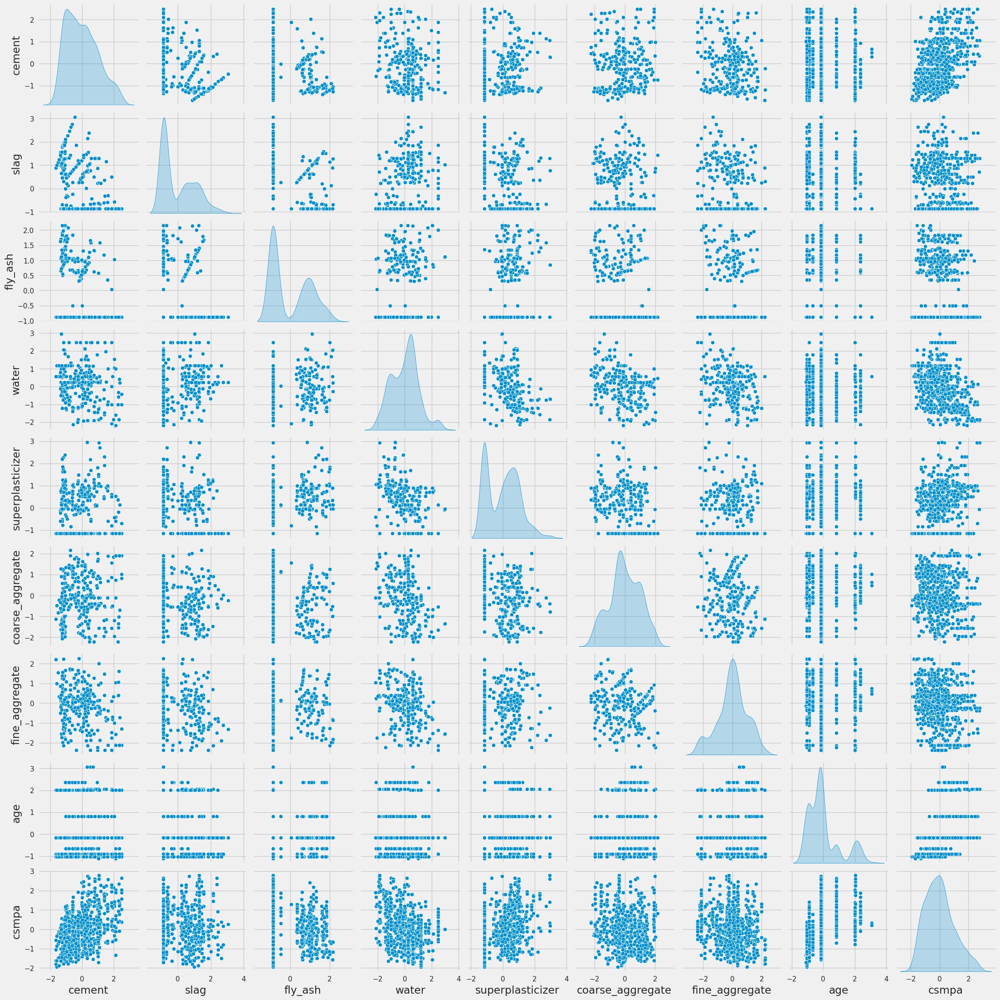

In [28]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
scaleddata1 = pd.DataFrame(sc.fit_transform(data1))
scaleddata1.columns = data1.columns
sns.pairplot(scaleddata1,diag_kind='kde')

# Compressive strength vs Cement , Age , water

<AxesSubplot:xlabel='cement', ylabel='csmpa'>

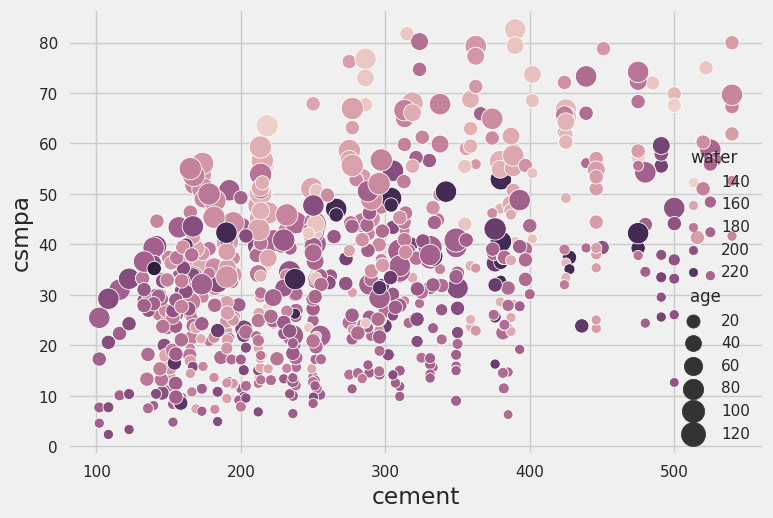

In [29]:
sns.scatterplot(y="csmpa", x="cement", hue="water",size="age", data=data1,sizes=(50, 300))

* **Compressive strength increases as the amount of cement increases**, as the dots move up when we move towards right on the x-axis.
* **Compressive strength increases with age** (as the size of dots represents the age), this not the case always but can be up to an extent.
* **Cement with less age requires more cement for higher strength**, as the smaller dots are moving up when we move towards right on the x-axis.
* **The older the cement is the more water it requires**, can be confirmed by observing the colour of the dots. Larger dots with dark colour indicate high age and more water.
* **Concrete strength increases when less water is used in preparing** it since the dots on the lower side (y-axis) are darker and the dots on higher-end (y-axis) are brighter.

In [30]:
data1.columns

Index(['cement', 'slag', 'fly_ash', 'water', 'superplasticizer',
       'coarse_aggregate', 'fine_aggregate', 'age', 'csmpa'],
      dtype='object')

# Basic Model1

In [31]:
# Basic model using all columns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
X = data1.drop('csmpa',axis= 1)
y = data1['csmpa']
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .27, random_state=10)
print(Xtrain.shape, Xtest.shape, ytrain.shape, ytest.shape)
lr = LinearRegression()
lr.fit(Xtrain,ytrain)
ypred_train = lr.predict(Xtrain)
ypred_test = lr.predict(Xtest)
RMSE_test1 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score :",RMSE_test1)
print("Training R2 :",lr.score(Xtrain,ytrain))
# print(lr.score(Xtrain,ytrain))
# print("Testing R2")
scores1 = lr.score(Xtest,ytest)
print("Testing R2 :",scores1)

(554, 8) (205, 8) (554,) (205,)
RMSE Score : 9.083253846451363
Training R2 : 0.7802396243562724
Testing R2 : 0.7123208176422384


Model				 RMSE 		 R2
Linear Regression 	 9.08 		0.71


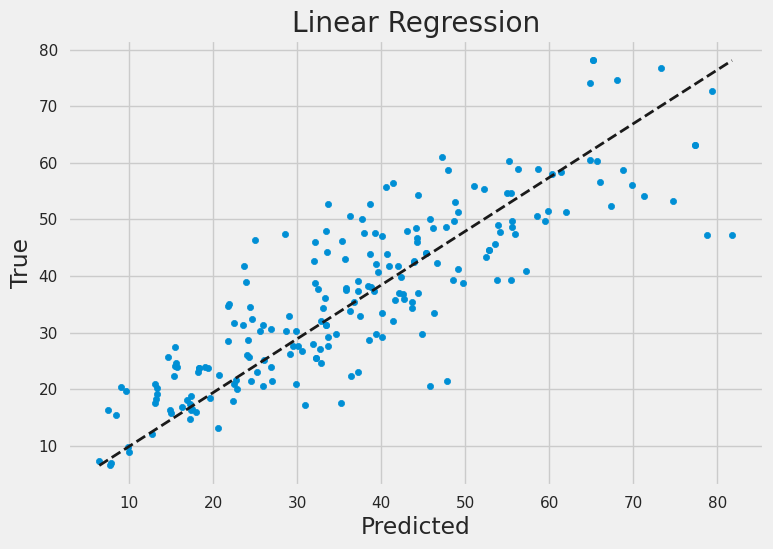

In [32]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t RMSE \t\t R2") 
print("Linear Regression \t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression") 
plt.show()

In [33]:
X.head()

,cement,slag,fly_ash,water,superplasticizer,coarse_aggregate,fine_aggregate,age
0,158.6,148.9,116.0,175.1,15.0,953.3,719.7,28
1,424.0,22.0,132.0,178.0,8.5,822.0,750.0,28
2,275.1,0.0,121.4,159.5,9.9,1053.6,777.5,3
3,252.0,97.0,76.0,194.0,8.0,835.0,821.0,28
4,168.9,42.2,124.3,158.3,10.8,1080.8,796.2,3


In [34]:
lr.coef_

array([ 0.10345821,  0.079988  ,  0.0501253 , -0.25944814,  0.17017628,
       -0.01132088, -0.00683647,  0.31931299])

# Model 2 (After Scaling of Data)

In [35]:
# using linear Regression after scaling of data to evaluate performance
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
sc=StandardScaler()
scaledXtrain = sc.fit_transform(Xtrain)
scaledXtest = sc.transform(Xtest)
lr = LinearRegression()
lr.fit(scaledXtrain,ytrain)
ypred_train = lr.predict(scaledXtrain)
ypred_test = lr.predict(scaledXtest)
RMSE_test2 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test2)

print("Training R2")
print(lr.score(scaledXtrain,ytrain))
print("Testing R2")
scores2 = lr.score(scaledXtest,ytest)
print(scores2)

RMSE Score 9.159869816279395
Training R2
0.781719463958868
Testing R2
0.7010092584847789


Model				 RMSE 		 R2
Linear Regression 		 9.16 			0.70


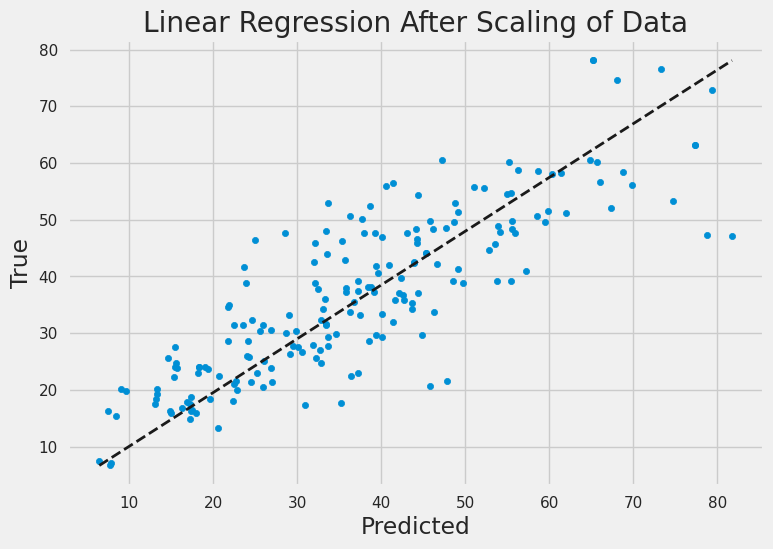

In [36]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t RMSE \t\t R2") 
print("Linear Regression \t\t {:.2f} \t\t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression After Scaling of Data") 
plt.show()

# Model 3 ( Using Pipeline) 

In [37]:
# Using pipeline to evaluate performance
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
pipe = Pipeline((
("sc",StandardScaler()),("lr", LinearRegression()),))
pipe.fit(Xtrain,ytrain)

ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test3 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test3)
print('Training R2')
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))

score_lr = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(score_lr)
print('Average R2')
scores3 = np.mean(score_lr)
print(scores3)

RMSE Score 9.159869816279395
Training R2
0.781719463958868
Testing R2
0.7010092584847789
[0.70550678 0.81800512 0.88080431 0.63655637 0.78096551 0.72624305
 0.80324397 0.74836846 0.83296948 0.73418361]
Average R2
0.7666846648518951


Model				 RMSE 		 R2
Linear Regression 		 9.16 		0.70


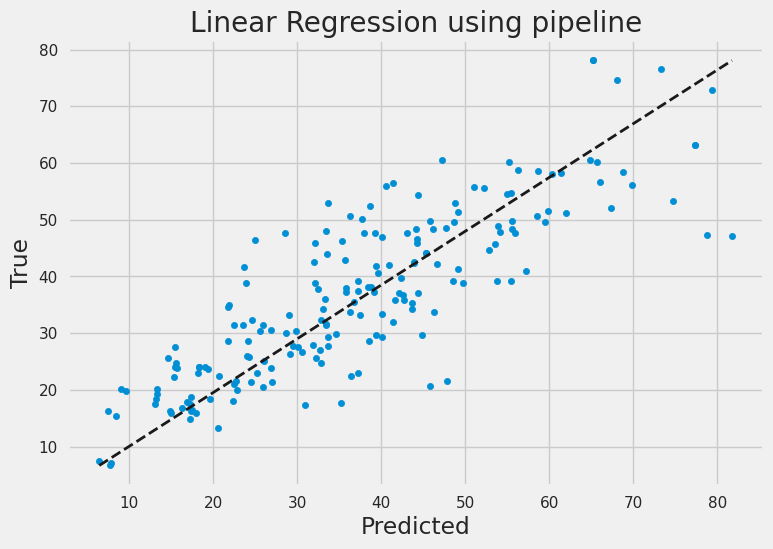

In [38]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t RMSE \t\t R2") 
print("Linear Regression \t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression using pipeline") 
plt.show()

In [39]:
pipe['lr'].coef_

array([[10.72165408,  6.94968084,  3.0393607 , -4.87919917,  1.01417955,
        -0.97148275, -0.61791786,  8.99070331]])

# Model 4 using PowerTransformer

In [40]:
#With Pipeline
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import cross_val_score
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
pipe = Pipeline((("pt",PowerTransformer()),("lr", LinearRegression()),))
pipe.fit(Xtrain,ytrain)
ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test4 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test4)
print("Training R2")
pipe.fit(Xtrain,ytrain)
print("Training R2")
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))
scores_lr = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(scores_lr)
print("Average R2")
scores4 = np.mean(scores_lr)
print(scores4)

RMSE Score 7.748935681598941
Training R2
Training R2
0.8439880733214603
Testing R2
0.7860248941700134
[0.80605545 0.84584178 0.88291171 0.82155113 0.8426519  0.82379968
 0.86481497 0.84920363 0.82146951 0.77853711]
Average R2
0.8336836868221678


Model							 RMSE 		 R2
Linear Regression with Power Transformer 		 7.75 		0.79


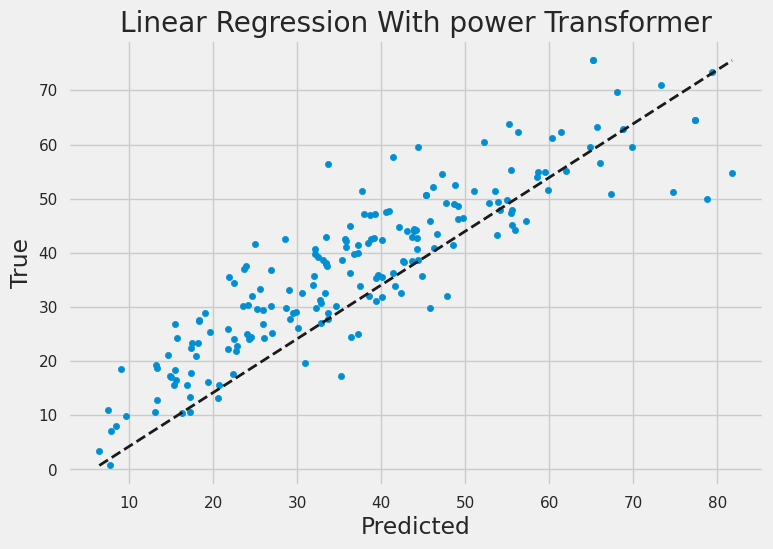

In [41]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t\t\t\t RMSE \t\t R2") 
print("Linear Regression with Power Transformer \t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression With power Transformer") 
plt.show()

# Model 5 (Using Lasso Regression)

In [42]:
from sklearn.linear_model import Lasso,Ridge
X = data1.drop('csmpa',axis=1)
y = data1['csmpa']
Xtrain,Xtest,ytrain,ytest = train_test_split(X,y,test_size= 0.25,random_state=10)
pipe = Pipeline((
    ('pt',PowerTransformer()),
    ('lr',Lasso(alpha=0)),
))
pipe.fit(Xtrain,ytrain)

ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test5 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test5)

print('Training R2')
print(pipe.score(Xtrain,ytrain))
print('Testing R2')
print(pipe.score(Xtest,ytest))
scores_las = cross_val_score(pipe,Xtrain,ytrain,cv= 10)
print(scores_las)
print('Average R2')
scores5 = np.mean(scores_las)
print(scores5)

RMSE Score 7.748935681598941
Training R2
0.8439880733214603
Testing R2
0.7860248941700134
[0.80605545 0.84584178 0.88291171 0.82155113 0.8426519  0.82379968
 0.86481497 0.84920363 0.82146951 0.77853711]
Average R2
0.8336836868221678


Model							 RMSE 		 R2
Linear Regression with Lasso Regression 		 7.75 		0.79


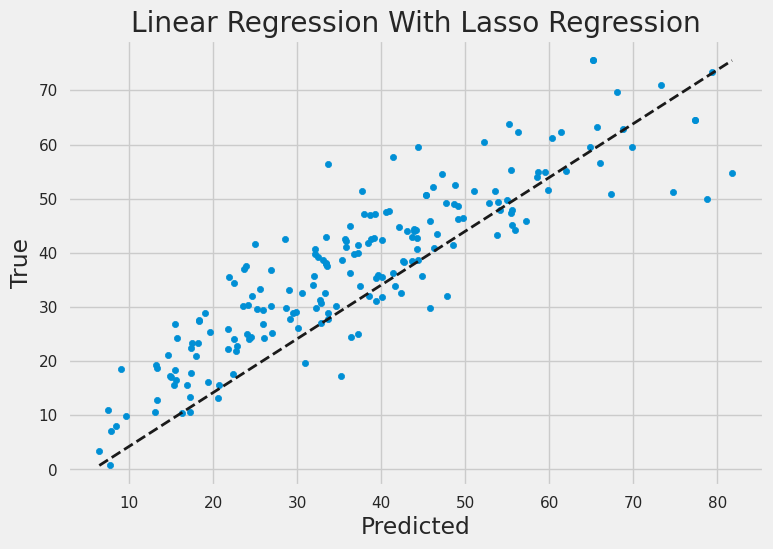

In [43]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t\t\t\t RMSE \t\t R2") 
print("Linear Regression with Lasso Regression \t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression With Lasso Regression") 
plt.show()

# Model 6 (Linear Regression- polynomial features,PowerTransformer, pipeline) 

In [44]:
# Using polynomial feature scaling ---Linear Regression with PowerTransformer
from sklearn.preprocessing import PolynomialFeatures
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
pipe = Pipeline((
("pt", PowerTransformer()),
("poly",PolynomialFeatures(degree=2)),
("lr", LinearRegression())
))
pipe.fit(Xtrain,ytrain)
ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test6 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test6)
print("Training R2")
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))
scores_poly_feature = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(scores_poly_feature)
print("Average R2")
scores6 = np.mean(scores_poly_feature)
print(scores6)

RMSE Score 6.482552665278163
Training R2
0.9055020176893124
Testing R2
0.8502484780008207
[0.82392461 0.9056821  0.81928074 0.75524978 0.9133705  0.88250808
 0.89459396 0.88312494 0.87676452 0.86784284]
Average R2
0.8622342077126828


Model							 RMSE 		 R2
Linear Regression with Polynomial Faeture 		 6.48 		0.85


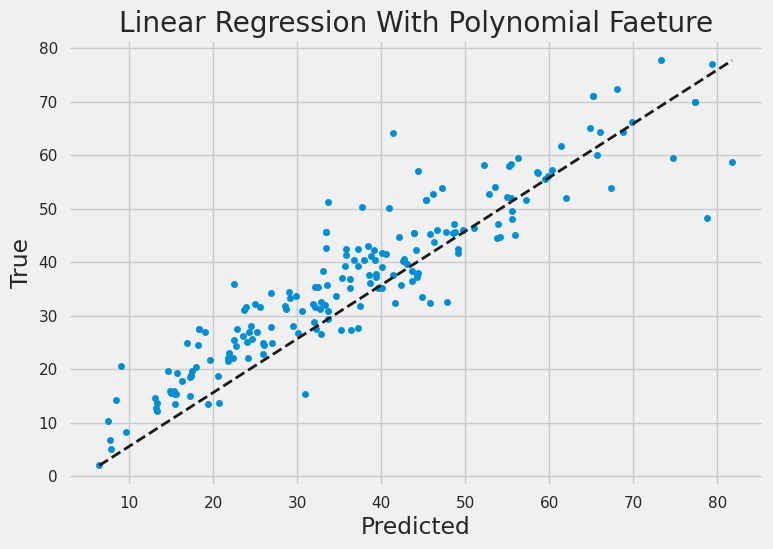

In [45]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t\t\t\t RMSE \t\t R2") 
print("Linear Regression with Polynomial Faeture \t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression With Polynomial Faeture") 
plt.show()

# Model 7 (Liear Regression with RFE(Recursive Feature Elimanation) and with Polynomial Feature and powerTransformer in Pipeline)

In [46]:
#(Liear Regression with RFE(Recursive Feature Elimanation) and with Polynomial Feature and powerTransformer in Pipeline)
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.feature_selection import RFE
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
pipe = Pipeline((
("pt",PowerTransformer()),
("poly",PolynomialFeatures(degree=3)),
("rfe",RFE(estimator=LinearRegression(),n_features_to_select=70)),
("lr", LinearRegression()),
))
pipe.fit(Xtrain,ytrain)

print("----------RMSE Score-------")
ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test7 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test7)
print("--------R2 Scores-------------")
print("Training R2")
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))
scores_rfe = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(scores_rfe)
print("Average R2")
scores7 = np.mean(scores_rfe)
print(scores7)

----------RMSE Score-------
RMSE Score 6.329705170130809
--------R2 Scores-------------
Training R2
0.9406025758235727
Testing R2
0.8572269948816436
[0.76626644 0.88374334 0.81842998 0.8661601  0.86640702 0.88512813
 0.92466909 0.90509118 0.72401323 0.88826038]
Average R2
0.8528168887330967


Model						 RMSE 		 R2
Linear Regression with RFE 			 6.33 		0.86


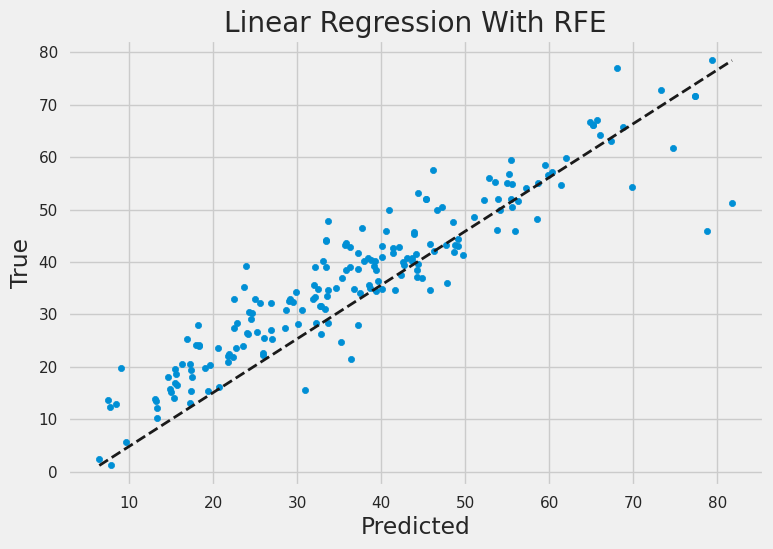

In [47]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t\t\t RMSE \t\t R2") 
print("Linear Regression with RFE \t\t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression With RFE") 
plt.show()

# Model 8 (Liear Regression with RFE(Recursive Feature Elimanation) and PCA with Polynomial Feature and powerTransformer in Pipeline)

In [48]:
#(Liear Regression with RFE(Recursive Feature Elimanation) and PCA with Polynomial Feature and powerTransformer in Pipeline)
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.feature_selection import RFE
from sklearn.decomposition import PCA
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
pipe = Pipeline((
("pt",PowerTransformer()),
("poly",PolynomialFeatures(degree=3)),
("pca",PCA(n_components=100)),
("lr", LinearRegression()),
))
pipe.fit(Xtrain,ytrain)
print("----------RMSE Score-------")
ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test8 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test8)
print("--------R2 Scores-------------")

print("Training R2")
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))
scores_pca = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(scores_pca)
print("Average R2")
scores8 = np.mean(scores_pca)
print(scores8)
# print(pipe['pca'].explained_variance_ratio_)

----------RMSE Score-------
RMSE Score 6.524520128915405
--------R2 Scores-------------
Training R2
0.9340354755877345
Testing R2
0.8483032458850273
[0.82137054 0.90340699 0.84358525 0.8139276  0.83541465 0.86971245
 0.90849246 0.92500149 0.81685805 0.91484861]
Average R2
0.8652618088304054


Model							 RMSE 		 R2
Linear Regression with RFE and PCA 			 6.52 		0.85


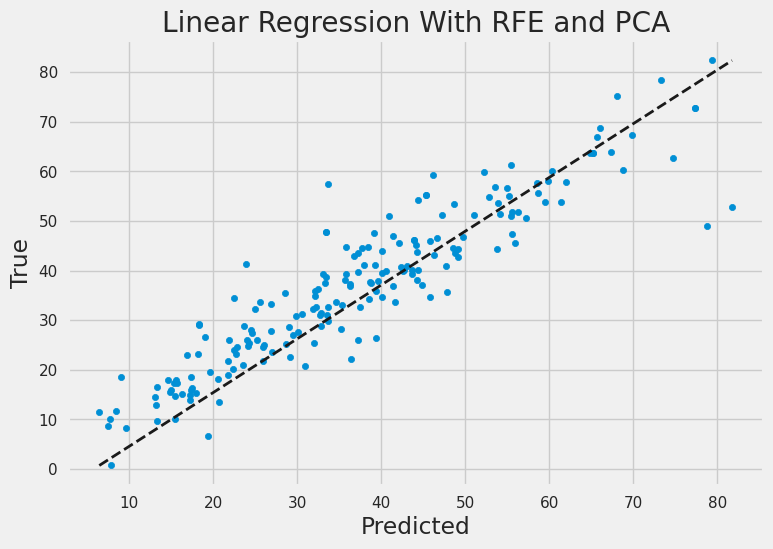

In [49]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t\t\t\t RMSE \t\t R2") 
print("Linear Regression with RFE and PCA \t\t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression With RFE and PCA") 
plt.show()

# Model 9 Decision Tree Regressor

In [50]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PowerTransformer
from sklearn.tree import DecisionTreeRegressor
X = data1.drop('csmpa',axis=1)
y = data1[['csmpa']]
Xtrain,Xtest,ytrain,ytest = train_test_split(X,y,test_size= 0.25,random_state=10)
pipe = Pipeline((
    ('pt',PowerTransformer()),
    ('dt',DecisionTreeRegressor(max_depth=20,random_state=10))
))
pipe.fit(Xtrain,ytrain)

print("----------RMSE Score-------")
ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test9 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test9)
print("--------R2 Scores-------------")

print("Training R2")
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))
scores_dt = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(scores_dt)
print("Average R2")
scores9 = np.mean(scores_dt)
print(scores9)

----------RMSE Score-------
RMSE Score 7.751763789106661
--------R2 Scores-------------
Training R2
0.9994524750229896
Testing R2
0.7858686778695808
[0.7480059  0.83136944 0.82626859 0.80048592 0.84810143 0.84142197
 0.72047631 0.8733603  0.76103353 0.84409028]
Average R2
0.8094613680029106


Model							 RMSE 		 R2
Decision Tree Regressor 				 7.75 		0.79


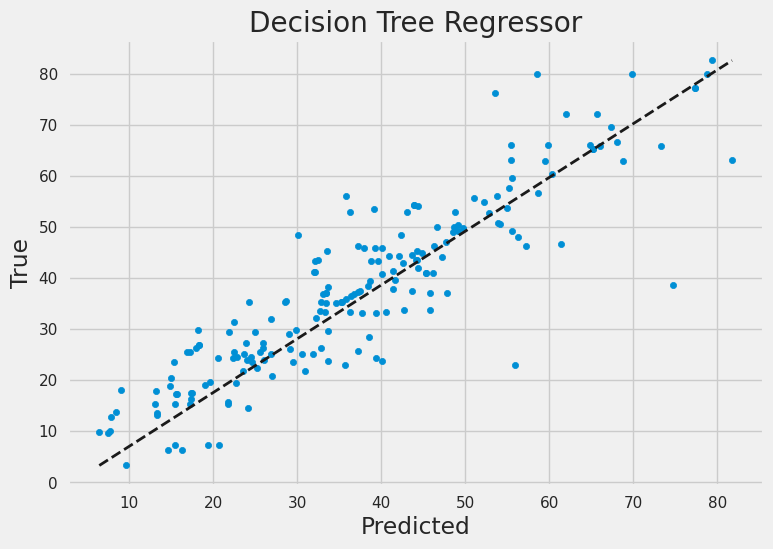

In [51]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t\t\t\t RMSE \t\t R2") 
print("Decision Tree Regressor \t\t\t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Decision Tree Regressor") 
plt.show()

# Model 10 - RandomForest Regressor

In [52]:
#With Pipeline with random forest Regressor
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PowerTransformer
from sklearn.ensemble import RandomForestRegressor
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
pipe = Pipeline((
("lr", RandomForestRegressor(n_estimators=200,random_state=10)),
))
pipe.fit(Xtrain,ytrain)

print("----------RMSE Score-------")
ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test10 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test10)
print("--------R2 Scores-------------")
print("Training R2")
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))
scores_rf = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(scores_rf)
print("Average R2")
scores10 = np.mean(scores_rf)
print(scores10)

----------RMSE Score-------
RMSE Score 5.792659163367881
--------R2 Scores-------------
Training R2
0.9854555640736925
Testing R2
0.8804264594503455
[0.86540626 0.90135512 0.87857888 0.87461071 0.88564119 0.90208738
 0.90133816 0.89810291 0.86517419 0.88804229]
Average R2
0.8860337086053122


Model							 RMSE 		 R2
Random Forest Regressor 				 5.79 		0.88


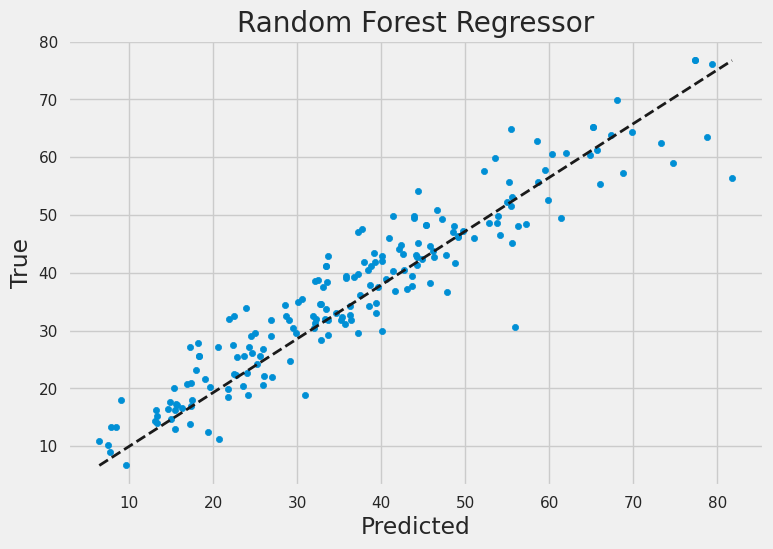

In [53]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t\t\t\t RMSE \t\t R2") 
print("Random Forest Regressor \t\t\t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Random Forest Regressor") 
plt.show()

# Model 11 --Linear Regression With pipeline and Gradient Boosting

In [54]:
#With Pipeline with gradient boosting
from sklearn.pipeline import Pipeline
from sklearn.ensemble import GradientBoostingRegressor
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
pipe = Pipeline((
("lr", GradientBoostingRegressor(n_estimators=1500,random_state=10)),
))
pipe.fit(Xtrain,ytrain)

print("----------RMSE Score-------")
ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test11 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test11)
print("--------R2 Scores-------------")

print("Training R2")
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))
scores_gb = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(scores_gb)
print("Average R2")
scores11 = np.mean(scores_gb)
print(scores11)

----------RMSE Score-------
RMSE Score 4.8782245389977925
--------R2 Scores-------------
Training R2
0.9973422640221153
Testing R2
0.9151986608377634
[0.90202768 0.92350684 0.8788382  0.83360432 0.89943774 0.88409454
 0.90408056 0.92755563 0.88005849 0.91842989]
Average R2
0.8951633887853309


Model										 RMSE 		 R2
Linear Regression with pipeline and Gradient Boosting 				 4.88 		0.92


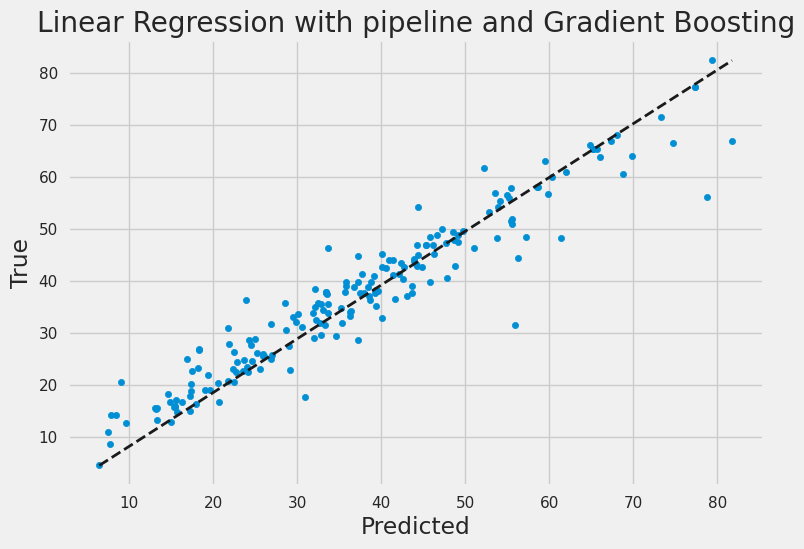

In [55]:
from sklearn.metrics import r2_score
print("Model\t\t\t\t\t\t\t\t\t\t RMSE \t\t R2") 
print("Linear Regression with pipeline and Gradient Boosting \t\t\t\t {:.2f} \t\t{:.2f}""".format( np.sqrt(mean_squared_error(ytest, ypred_test)), r2_score(ytest, ypred_test))) 
plt.scatter(ytest, ypred_test,s=20) 
plt.plot([ytest.min(), ytest.max()], [ypred_test.min(), ypred_test.max()], 'k--', lw=2) 
plt.xlabel("Predicted") 
plt.ylabel("True") 
plt.title("Linear Regression with pipeline and Gradient Boosting") 
plt.show()

In [56]:
pipe['lr'].estimators_

array([[DecisionTreeRegressor(criterion='friedman_mse', max_depth=3,
                      random_state=RandomState(MT19937) at 0x7F0B3A39F7C0)],
       [DecisionTreeRegressor(criterion='friedman_mse', max_depth=3,
                      random_state=RandomState(MT19937) at 0x7F0B3A39F7C0)],
       [DecisionTreeRegressor(criterion='friedman_mse', max_depth=3,
                      random_state=RandomState(MT19937) at 0x7F0B3A39F7C0)],
       ...,
       [DecisionTreeRegressor(criterion='friedman_mse', max_depth=3,
                      random_state=RandomState(MT19937) at 0x7F0B3A39F7C0)],
       [DecisionTreeRegressor(criterion='friedman_mse', max_depth=3,
                      random_state=RandomState(MT19937) at 0x7F0B3A39F7C0)],
       [DecisionTreeRegressor(criterion='friedman_mse', max_depth=3,
                      random_state=RandomState(MT19937) at 0x7F0B3A39F7C0)]],
      dtype=object)

# Graphical Representation of Model

In [57]:
# Model_Names=["Model1","Model2","Model3","Model4","Model5","Model6",'Model7','Model8','Model9','Model10','Model11']
Model_Names = ["LR Model","LR with scaled data","LR with pipeline","LR with Power Transformer","Lasso Regression",
              "Lasso with pipeline",'LR with RFE','LR with PCA','DT Regressor','RF Regressor','LR with GB']
RMSE_Scores = [RMSE_test1,RMSE_test2,RMSE_test3,RMSE_test4,RMSE_test5,RMSE_test6,RMSE_test7,RMSE_test8,RMSE_test9,RMSE_test10,RMSE_test11]
Scores=[scores1,scores2,scores3,scores4,scores5,scores6,scores7,scores8,scores9,scores10,scores11]

# Performance of RMSE and R2 of diffierent model

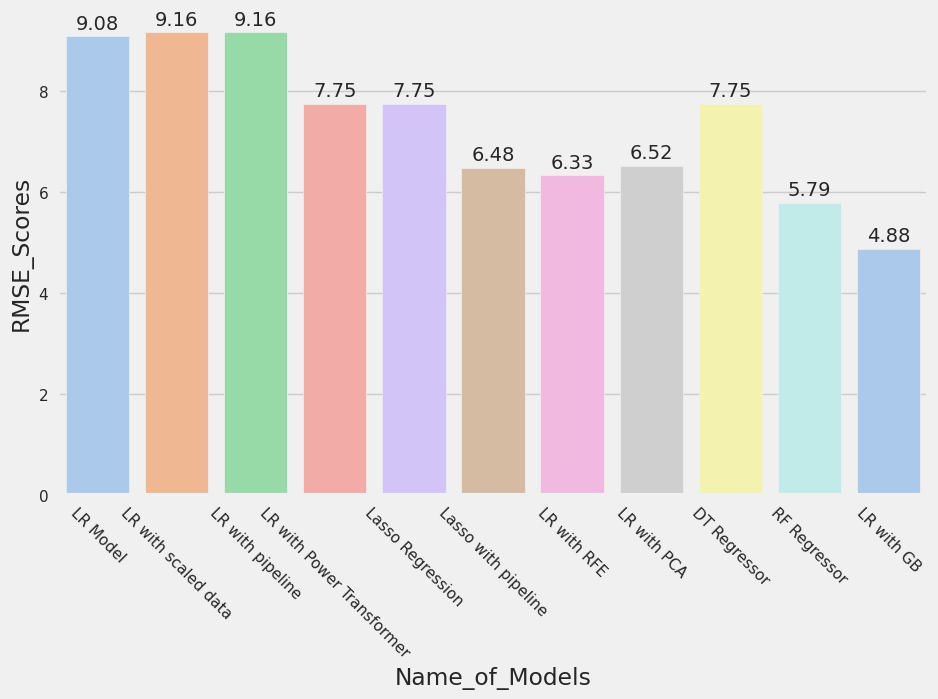

In [58]:
import matplotlib.pyplot as plt
graph_data = pd.DataFrame(list(zip(Model_Names,RMSE_Scores)),columns=['Name_of_Models','RMSE_Scores'])
# graph_data
plt.figure(figsize=(10,6))
plt.xticks(rotation=-45)
g = sns.barplot(x=graph_data["Name_of_Models"],y=graph_data["RMSE_Scores"],palette='pastel')

for p in g.patches:
  g.annotate(format(p.get_height(),".2f"),
             (p.get_x()+p.get_width()/2.,p.get_height()),ha='center',va= 'center',xytext=(0,9),textcoords='offset points')

# Performance of R- Squared of diffierent model

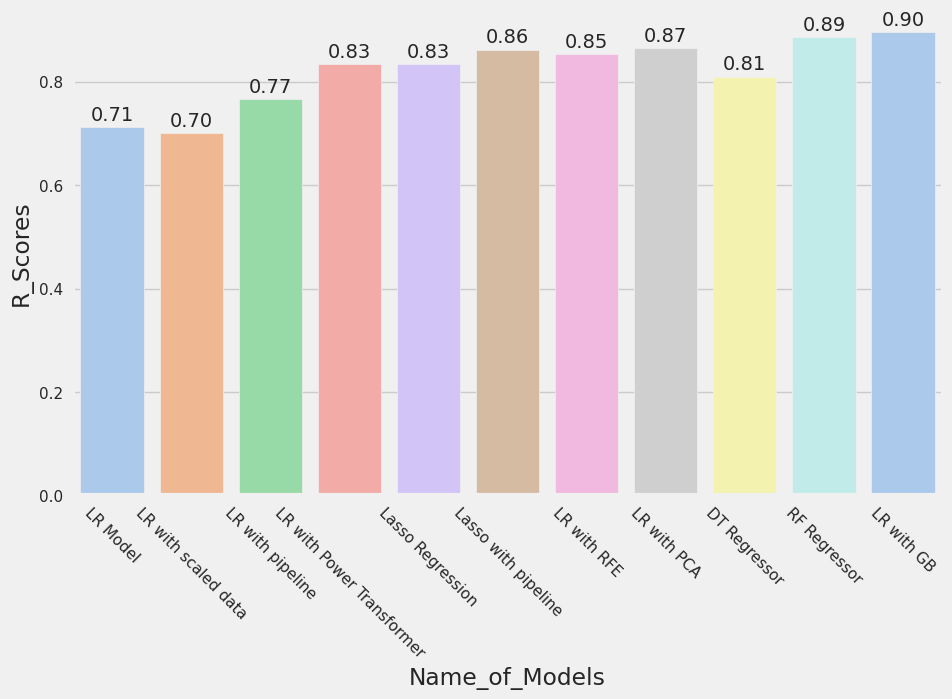

In [59]:
graph_data1 = pd.DataFrame(list(zip(Model_Names,Scores)),columns=['Name_of_Models','R_Scores'])
# graph_data
plt.figure(figsize=(10,6))
plt.xticks(rotation=-45)
g1 = sns.barplot(x=graph_data1["Name_of_Models"],y=graph_data1["R_Scores"],palette='pastel')

for p in g1.patches:
  g1.annotate(format(p.get_height(),".2f"),
             (p.get_x()+p.get_width()/2.,p.get_height()),ha='center',va= 'center',xytext=(0,9),textcoords='offset points')

 The best model is Linear Regression with Gradient Boosting .

In [60]:
#With Pipeline with gradient boosting
from sklearn.pipeline import Pipeline
from sklearn.ensemble import GradientBoostingRegressor
X=data1.drop('csmpa',axis=1)
y=data1[['csmpa']]
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size= .25,random_state=10)
pipe = Pipeline((
("lr", GradientBoostingRegressor(n_estimators=1500,random_state=10)),
))
pipe.fit(Xtrain,ytrain)

print("----------RMSE Score-------")
ypred_train = pipe.predict(Xtrain)
ypred_test = pipe.predict(Xtest)
RMSE_test11 = np.sqrt(mean_squared_error(ytest, ypred_test)) 
print("RMSE Score",RMSE_test11)
print("--------R2 Scores-------------")

print("Training R2")
print(pipe.score(Xtrain,ytrain))
print("Testing R2")
print(pipe.score(Xtest,ytest))
scores_gb = cross_val_score(pipe,Xtrain,ytrain,cv=10)
print(scores_gb)
print("Average R2")
scores11 = np.mean(scores_gb)
print(scores11)

----------RMSE Score-------
RMSE Score 4.8782245389977925
--------R2 Scores-------------
Training R2
0.9973422640221153
Testing R2
0.9151986608377634
[0.90202768 0.92350684 0.8788382  0.83360432 0.89943774 0.88409454
 0.90408056 0.92755563 0.88005849 0.91842989]
Average R2
0.8951633887853309


In [61]:
ypred_test.shape

(190,)

#Conclusion

We have analysed the Compressive Strength Data and used Machine Learning to Predict the Compressive Strength of Concrete. We have used Linear Regression and its variations, Decision Trees and Random Forests to make predictions and compared their performance. Linear Regression with Gradient boosting has the lowest RMSE and is a good choice for this problem.